In [1]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import os
import glob
import json
import matplotlib.pyplot as plt 
import seaborn as sns 
import datetime
from collections import Counter
from nltk.corpus import stopwords as sw
import re
import collections
import itertools

import imageio
import folium
import folium.plugins as plugins
from mpl_toolkits.basemap import Basemap

#viz
import matplotlib.pyplot as plt
import seaborn as sns 
import matplotlib.gridspec as gridspec 
import matplotlib.gridspec as gridspec 

# graph viz
import plotly.offline as pyo
from plotly.graph_objs import *
import plotly.graph_objs as go

### Getting dataset
### Please download the yelp_academic_dataset_business.json file using https://www.yelp.com/dataset/! The original json is too big for Gradescope.

In [2]:
file = open("yelp_academic_dataset_business.json", 'r')
business = []
for line in file.readlines():
    dic = json.loads(line)
    business.append(dic)
business=pd.DataFrame(business)

In [3]:
path = os.getcwd() + "/sample_review_file.csv"
data = pd.read_csv(path)

# Part 2: Overview & Processing Dataset Business and User

In [4]:
business.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."


In [5]:
business.describe().T

,count,mean,std,min,25%,50%,75%,max
latitude,150346.0,36.671150,5.872759,27.555127,32.187293,38.777413,39.954036,53.679197
longitude,150346.0,-89.357339,14.918502,-120.095137,-90.357810,-86.121179,-75.421542,-73.200457
stars,150346.0,3.596724,0.974421,1.000000,3.000000,3.500000,4.500000,5.000000
review_count,150346.0,44.866561,121.120136,5.000000,8.000000,15.000000,37.000000,7568.000000
is_open,150346.0,0.796150,0.402860,0.000000,1.000000,1.000000,1.000000,1.000000


In [6]:
# Number of rows and columns
business.shape

(150346, 14)

In [7]:
business.columns

Index(['business_id', 'name', 'address', 'city', 'state', 'postal_code',
       'latitude', 'longitude', 'stars', 'review_count', 'is_open',
       'attributes', 'categories', 'hours'],
      dtype='object')

<AxesSubplot: >

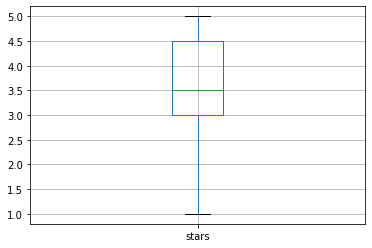

In [8]:
#to check whether there is some outlier data

business[['stars']].boxplot()

<AxesSubplot: >

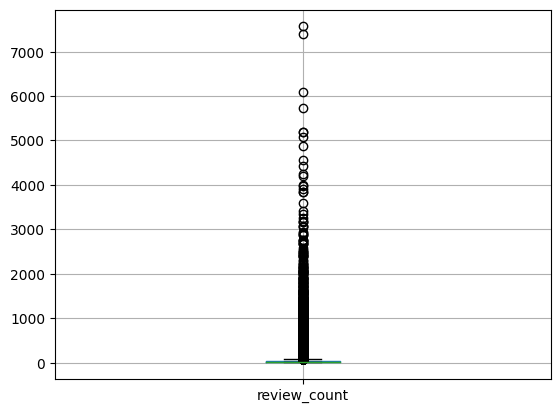

In [9]:
business[['review_count']].boxplot()

In [10]:
business.isnull().sum()

business_id         0
name                0
address             0
city                0
state               0
postal_code         0
latitude            0
longitude           0
stars               0
review_count        0
is_open             0
attributes      13744
categories        103
hours           23223
dtype: int64

In [11]:
business.replace(np.nan,'0',inplace=True)

business.isnull().sum()

business_id     0
name            0
address         0
city            0
state           0
postal_code     0
latitude        0
longitude       0
stars           0
review_count    0
is_open         0
attributes      0
categories      0
hours           0
dtype: int64

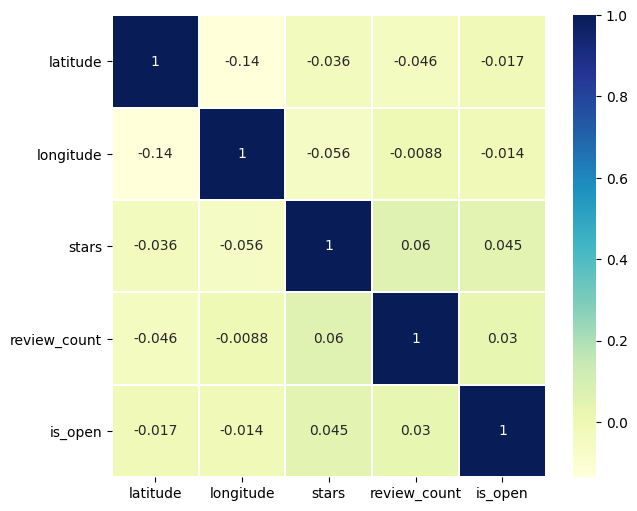

In [12]:
#create the correlation matrix heat map
plt.figure(figsize=(7,6))

sns.heatmap(business.corr(),linewidths=.1,cmap="YlGnBu", annot=True)

plt.yticks(rotation=0);

# Generating Categories

There are  54545  different types/categories of Businesses in Yelp!


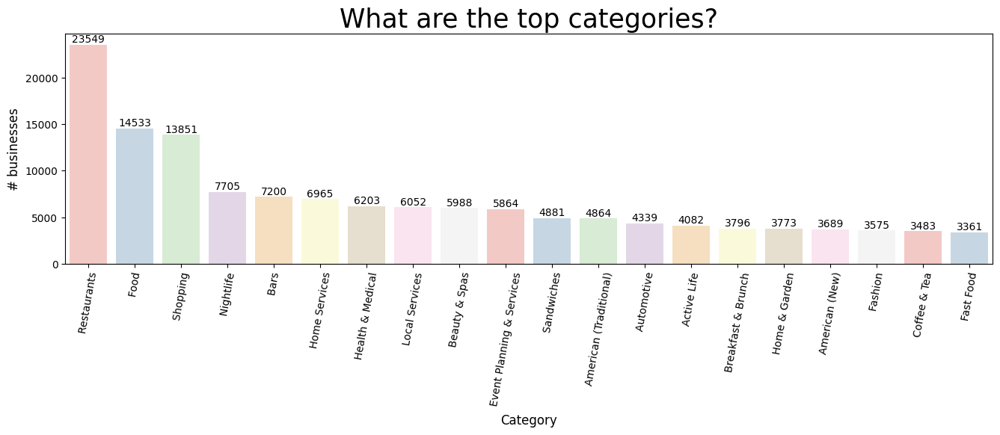

In [13]:
# What are the popular business categories?
business_cats=' '.join('%s' %id for id in business['categories'])

cats=pd.DataFrame(business_cats.split(','),columns=['category'])
x=cats.category.value_counts()
print("There are ",len(x)," different types/categories of Businesses in Yelp!")
#prep for chart
x=x.sort_values(ascending=False)
x=x.iloc[0:20]

#chart
plt.figure(figsize=(16,4))
ax = sns.barplot(x.index, x.values, alpha=0.8, palette='Pastel1')#,color=color[5])
plt.title("What are the top categories?",fontsize=25)
locs, labels = plt.xticks()
plt.setp(labels, rotation=80)
plt.ylabel('# businesses', fontsize=12)
plt.xlabel('Category', fontsize=12)

#adding the text labels
rects = ax.patches
labels = x.values
for rect, label in zip(rects, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom')

plt.show()

In [14]:
#Updating the column of categories to category
business_cats=''.join('%s' %id for id in business['categories'])
cats=pd.DataFrame(business_cats.split(','),columns=['category'])
x=cats.category.value_counts()
l=list(x.index[:10])
print(l)

def findCateg(x):
    if x.categories is None:
        return 'None'
    for i in list(x.categories.split(',')):
        if i in l:
            return i
    return 'others'

business["category"] = business.apply(findCateg,axis=1)

[' Restaurants', ' Food', ' Shopping', ' Nightlife', ' Bars', ' Home Services', ' Health & Medical', ' Local Services', ' Beauty & Spas', ' Event Planning & Services']


## Some fundamental analysis and explorations about the business dataset in Yelp
### 1. The proportion of business with different star rating

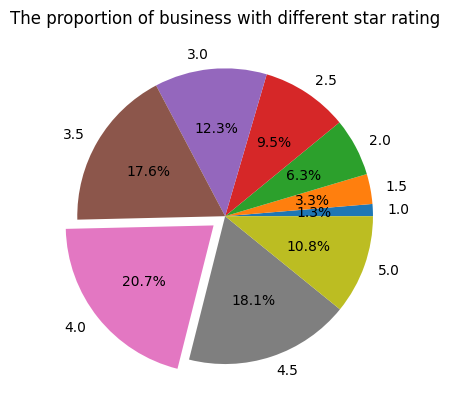

In [15]:
#plot the proportion of business with different star rating
plt1 = business['stars'].value_counts().sort_index()
explode = (0, 0, 0, 0, 0, 0, 0.1, 0, 0)
plt.pie(plt1, explode=explode, autopct='%.1f%%', labels=plt1.index, )
plt.title('The proportion of business with different star rating',fontsize=12)
plt.show()

> Among the star ratings of all businesses, the largest proportion is a rating of 4.0. More than 1/2 of the businesses have a star rating between 3.5 and 4.5. We also notice that, the number of businesses with ratings below 4.5 shows a decreasing trend as the rating decreases. This may indicate that a normal business’ star rating is likely to fall in the 3.5 to 4.5 range, while those with poor ratings have a lower probability to continue operating for various reasons.

### 2. The proportion of business with different categories

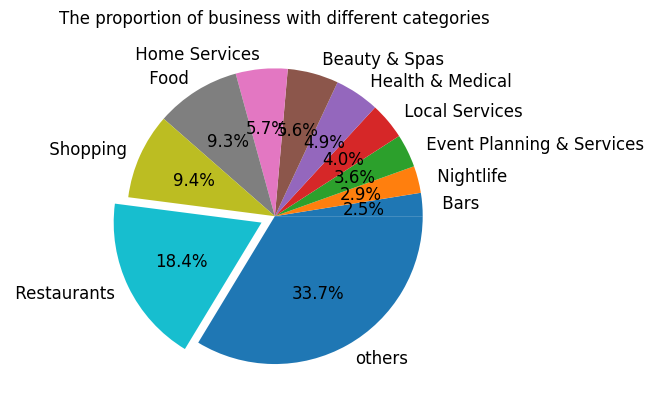

In [16]:
#plot the proportion of business with different categories
plt2 = business['category'].value_counts().sort_values()
explode = (0, 0, 0, 0, 0, 0, 0, 0, 0, 0.1, 0)
plt.pie(plt2, explode=explode,autopct='%.1f%%', labels=plt2.index, textprops={'fontsize': 12})
plt.title('The proportion of business with different categories',fontsize=12)
plt.show()

> This graph shows that restaurant is the most popular type of business on yelp. Other common types of businesses include shopping, food, home services, beauty & spas, health & medical, local services, etc.

### 3. The average review number of business with different star rating

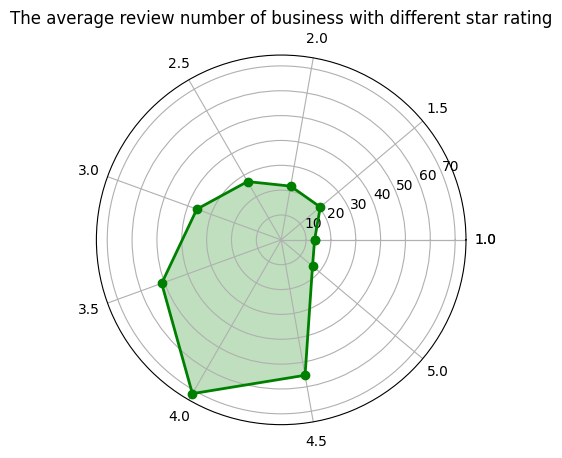

In [17]:
#plot the average review number of business with different star rating by using radar chart
plt1_2 = business.groupby(['stars'])['review_count'].mean()

labels = plt1_2.index
dataLenth  = 9
data = np.array(plt1_2)
angles = np.linspace(0,2*np.pi,dataLenth,endpoint=False)

data = np.concatenate((data,[data[0]])) 
angles = np.concatenate((angles,[angles[0]]))
labels=np.concatenate((labels,[labels[0]]))  
 
fig = plt.figure(facecolor="white")       
plt.subplot(111,polar=True)  
plt.plot(angles,data,'bo-',color ='g',linewidth=2)
plt.fill(angles,data,facecolor='g',alpha=0.25)   
plt.thetagrids(angles*180/np.pi,labels)         
plt.grid(True)
plt.title('The average review number of business with different star rating',fontsize=12)
plt.show()

> The graph above shows that businesses with 4.0 points of stars have an average of 71 review numbers, whereas businesses with 1.0 points of stars have an average of 13 review numbers which is the lowest. 
> An interesting fact is that businesses with 5.0 points of stars received relatively a low number of reviews: 16. This indicates that some businesses rate better not because they are offering great services, but because only a few reviews are received.

### 4. Using widgets to achieve interactive analysis

In [18]:
import sys
from datetime import datetime
import datetime
from sanddance import Explorer
import pandas_sanddance
from pandas_sanddance import SandDanceWidget as sdw
np.set_printoptions(threshold=sys.maxsize)
pd.set_option('max_columns',None)
pd.set_option('mode.chained_assignment', None)

In [19]:
#Define different region in USA
west=['WA','OR','CA','NV','UT','ID','MT','WY','CO','HI','AK']
southwest=['AZ','NM','OK','TX']
midwest=['ND','SD','NE','KS','MN','IA','MO','WI','IL','MI','IN','OH']
southeast=['AR','LA','MS','KY','TN','AL','WV','DC','VA','NC','SC','GA','FL']
northeast=['PA','NY','VT','ME','NH','MA','CT','RI','NJ','DE','MD']
def find_region(value):
    if value in west:
        return 'west'
    elif value in southwest:
        return 'southwest'
    elif value in midwest:
        return 'midwest'
    elif value in southeast:
        return 'southeast'
    elif value in northeast:
        return 'northeast'
business['region']=business['state'].apply(lambda x: find_region(x))

In [20]:
#Generate a new dataframe that deduct business in 'Other' category
deduct_business=business[business['category']!='None']

+ **Notes for Graph 1:** 
```shell
"Title: Stars Rating by Region"
```
 
 By using Bar chart and adding **'Stars'** as its y-axis, also with the data colored and sorted by **'Region'**. We can get a closer look about the rating on Yelp for business in different regions.
 
 Besides, **'review_count'** can also be added as its z-axis and draw a 3D graph. This can help us take a closer look at the review recieved for business in different regions and with different stars rating.
 
+ **Notes for Graph 3:** 
```shell
"Title: Stars Rating by Category"
```
 
 By using Bar chart and adding **'Stars'** as its y-axis, also with the data colored and sorted by **'Category'**. We can get a closer look about the rating on Yelp for business in different categories.
 
 Besides, **'review_count'** can also be added as its z-axis and draw a 3D graph. This can help us take a closer look at the review recieved for business in different categories and with different stars rating.


 

In [21]:
widget=sdw()
widget.show()
widget.load(business)

SandDanceWidget()

 + **Notes for Graph 3:** 
```shell
"Title: Comparison between Open Business and Already Closed Business"
```
 
 By using Scatter plot and adding **'Stars'** as its x-axis, **'Review_count'** as its y-axis, **'is_open'** as its z-axis. Besides,it also let the data be colored and sorted by **'Region'**. We can get a closer look about the different situation between still open business and already closed business.


 

In [22]:
widget=sdw()
widget.show()
widget.load(deduct_business)

SandDanceWidget()

## Based on the above analysis, let's see what is the most popular restaurants!

> Definition of whether a restaurant is popular: We include restaurants with a rating of 4.5 and more than 100 reviews. 

In [23]:
pop_restaurants = business[(business["stars"] == 4.5) & (business["review_count"] > 100)  & (business["category"] ==" Restaurants") ]  #
pop_restaurants = pop_restaurants.sort_values(by="review_count", ascending=False) 
print('The top 10 popular restaurants: ')
pop_restaurants.iloc[0:10]

The top 10 popular restaurants: 


,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,category,region
91757,GXFMD0Z4jEVZBCsbPf4CTQ,Hattie B’s Hot Chicken - Nashville,112 19th Ave S,Nashville,TN,37203,36.151387,-86.796603,4.5,6093,1,"{'RestaurantsGoodForGroups': 'True', 'Business...","American (Traditional), Chicken Shop, Southern...","{'Monday': '0:0-0:0', 'Tuesday': '11:0-16:0', ...",Restaurants,southeast
31332,_C7QiQQc47AOEv4PE3Kong,Commander's Palace,1403 Washington Ave,New Orleans,LA,70130,29.928735,-90.084196,4.5,4876,1,"{'RestaurantsGoodForGroups': 'True', 'OutdoorS...","French, Restaurants, Cocktail Bars, Nightlife,...","{'Monday': '0:0-0:0', 'Tuesday': '18:0-21:30',...",Restaurants,southeast
132673,I_3LMZ_1m2mzR0oLIOePIg,Pappy's Smokehouse,3106 Olive St,Saint Louis,MO,63103,38.635147,-90.224003,4.5,3999,1,"{'Alcohol': 'u'none'', 'RestaurantsAttire': ''...","Food, Restaurants, Caterers, Smokehouse, Barbe...","{'Monday': '0:0-0:0', 'Tuesday': '11:0-16:0', ...",Restaurants,midwest
49618,gTC8IQ_i8zXytWSly3Ttvg,Cochon Butcher,930 Tchoupitoulas St,New Orleans,LA,70130,29.942236,-90.067098,4.5,3837,1,"{'RestaurantsAttire': 'u'casual'', 'BusinessAc...","Shopping, Butcher, Restaurants, Sandwiches, Fo...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",Restaurants,southeast
129349,yPSejq3_erxo9zdVYTBnZA,Los Agaves,600 N Milpas St,Santa Barbara,CA,93101,34.427494,-119.686624,4.5,3834,1,"{'WiFi': 'u'no'', 'RestaurantsTakeOut': 'True'...","Mexican, Restaurants","{'Monday': '11:0-21:0', 'Tuesday': '11:0-21:0'...",Restaurants,west
73096,VVH6k9-ycttH3TV_lk5WfQ,Willie Mae's Scotch House,2401 St Ann St,New Orleans,LA,70119,29.969195,-90.078964,4.5,3582,1,"{'RestaurantsReservations': 'False', 'NoiseLev...","Comfort Food, Restaurants, Southern","{'Monday': '11:0-15:0', 'Tuesday': '11:0-15:0'...",Restaurants,southeast
120856,dsfRniRgfbDjC8os848B6A,Bern's Steak House,1208 S Howard Ave,Tampa,FL,33606,27.931862,-82.482700,4.5,2924,1,"{'OutdoorSeating': 'False', 'RestaurantsDelive...","Arts & Entertainment, Steakhouses, Restaurants","{'Monday': '17:0-22:0', 'Tuesday': '17:0-22:0'...",Restaurants,southeast
64928,6ajnOk0GcY9xbb5Ocaw8Gw,Barbuzzo,110 S 13th St,Philadelphia,PA,19107,39.950007,-75.162158,4.5,2893,1,"{'WiFi': 'u'no'', 'Caters': 'False', 'Restaura...","Mediterranean, Restaurants, Pizza, Italian","{'Monday': '17:0-22:0', 'Tuesday': '17:0-22:0'...",Restaurants,northeast
120871,ww3YJXu5c18aGZXWmm00qg,Café Amelie,912 Royal St,New Orleans,LA,70116,29.959867,-90.062903,4.5,2756,1,"{'RestaurantsReservations': 'True', 'NoiseLeve...","Southern, American (New), Breakfast & Brunch, ...","{'Thursday': '17:0-21:0', 'Friday': '17:0-21:0...",Restaurants,southeast
26266,xlMQBBt9wrtahdqiRDcVSg,The Stillery,113 2nd Ave N,Nashville,TN,37201,36.162249,-86.775712,4.5,2588,1,"{'BikeParking': 'True', 'CoatCheck': 'False', ...","American (New), Restaurants, Pubs, Beer, Wine ...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",Restaurants,southeast


In [24]:
from geopy.geocoders import ArcGIS
nom=ArcGIS()
nom.geocode("Tulsa,OK")

Location(Tulsa, Oklahoma, (36.15011000000004, -95.99351999999999, 0.0))

In [25]:
import folium
import branca
import branca.colormap as cm
#we are passing Into Map location coodinates of Tughlakabad,new delhi which we found in avove codes.
#using geopy library
a_map=folium.Map(location=[36.15011000000004, -95.99351999999999],zoom_start=4)
the_map=a_map

filter_business=business[business['review_count']>37]
list_coor=filter_business[['stars','latitude','longitude','review_count']].values.tolist()

colormap=cm.LinearColormap(colors=['red','lightgreen'],index=[0,5],vmin=0,vmax=5)

for i in list_coor:
    the_map.add_child(folium.Circle(location=[i[1],i[2]],
                                    radius=30*i[3],
                                    fill=True,
                                    #fill_opacity=0.7,
                                    color=colormap(i[0])
                                    ))
the_map

+ **Notes for Graph 4:** 
```shell
"Title: Geometric Distribution for Popular Business"
```
 
 By using GeoMap and choosing Top 25% business based on the number of **'review_count'**, we can get the Geometric distribution of them. The color represents its **'stars'** value and the radius represents its **'review_count'** value. 

### 4. Top 10 cities or states with highest number of business

In [26]:
plt3 = business['city'].value_counts().sort_values(ascending = False)
#plt3 = plt3[0:10]
plt3.to_csv('temp.csv')

In [27]:
plt4 = business['state'].value_counts().sort_values(ascending = False)
plt4 = plt4[0:10]
plt4= plt4[::-1]
plt4

AB     5573
NV     7715
NJ     8536
AZ     9912
LA     9924
MO    10913
IN    11247
TN    12056
FL    26330
PA    34039
Name: state, dtype: int64

 # Part 3: Overview & Processing Dataset Review

### Exploring the Numerical Features in Review Dataset

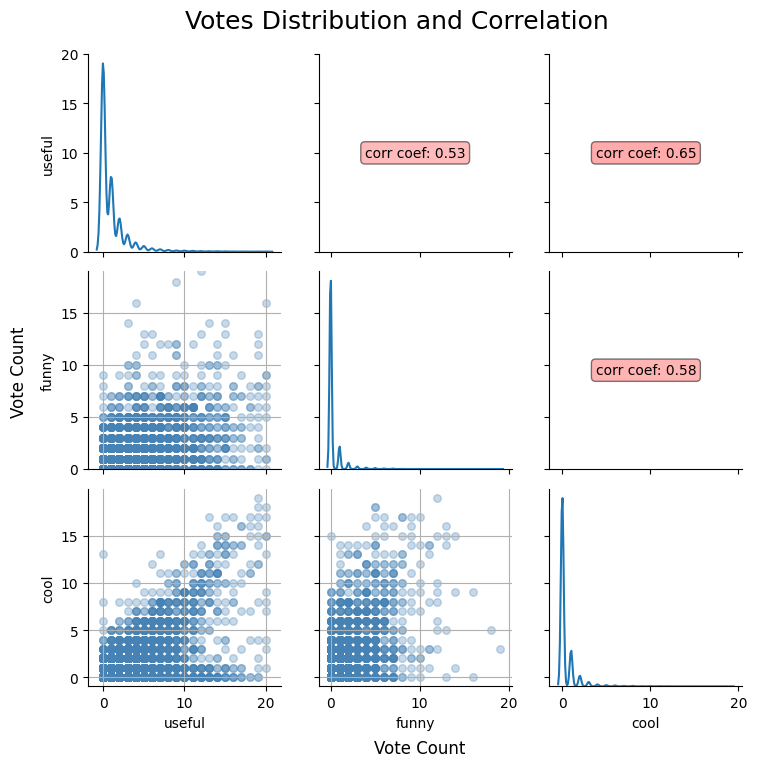

In [28]:
import matplotlib
from scipy.stats import pearsonr
from scipy.stats import linregress
import plotly as ply

Review_S= pd.read_csv('./sample_review_file.csv')
Review_S.drop(['Unnamed: 0'], axis = 1, inplace = True)
# Calculate the correlation coefficient
def cal_correlate(s1, s2):
    return round(pearsonr(s1, s2)[0], 2)

item_data = Review_S.loc[:, ['useful', 'funny', 'cool']]
item_data = item_data[(item_data['useful']<=20)&(item_data['funny']<=20)&(item_data['cool']<=20)]

# Customize regression plot
def customize_replot(*args, **kwargs):
    df = pd.concat([args[0], args[1]], axis=1)
    ax = sns.regplot(df.columns[0], df.columns[1], data=df, ci=None,
                     line_kws={'color': 'r', 'linewidth': 0},
                     scatter_kws={'s': 30, 'alpha': 0.3, 'color': 'steelblue'})
    ax.grid()
    

def customize_correlate(*args, **kwargs):
    corr = cal_correlate(args[0], args[1])
    max_x, min_x = np.max(args[0]), np.min(args[0])
    max_y, min_y = np.max(args[1]), np.min(args[0])
    text_x = (max_x + min_x) / 2
    text_y = (max_y + min_y ) /2
    
    cm = matplotlib.cm.bwr
    # Scale the correlation coefficient to the range of 0-1 and get the corresponding color
    rescale = (float(corr) + 1) / 2
    clr = cm(rescale)
    
    plt.text(text_x, text_y, 'corr coef: {}'.format(corr), fontsize=10, 
             ha='center', va='center',
             bbox={'boxstyle': 'round,pad=0.3', 'fc': clr, 'alpha': 0.5})
    plt.ylim(min_y, max_y)

p = sns.PairGrid(item_data, diag_sharey=False)
# draw the subplot in the upper triangle
p.map_upper(customize_correlate)
# draw the subplot on the diagonal
p.map_diag(sns.kdeplot)
# draw the subplot in the lower triangle
p.map_lower(customize_replot)
plt.subplots_adjust(top=0.92)
fig_grid = plt.gcf()
fig_grid.suptitle('Votes Distribution and Correlation', fontsize=18)


cm = matplotlib.cm.bwr
norm = matplotlib.colors.Normalize(vmin=-1, vmax=1)
sm = matplotlib.cm.ScalarMappable(norm=norm, cmap=cm)
sm.set_array([-1.0, -0.5, 0, 0.5, 1.0])

plt.text(10, -8, 'Vote Count', ha='center',fontsize=12)
plt.text(-35, 28, 'Vote Count', ha='center',fontsize=12,rotation='vertical')
plt.show()

- **On the diagonal:** the distribution of each type of review votes
- **The lower triangle:** the scatterplots of every two vote types
- **The upper triangle:** the correlation coefficients between them   

<font size=4>1. All the three distributions have a long-tailed shape, which means the vast majority of reviews have 0 or a small number of votes, and **people tend to vote for a review saying it’s useful, compared to funny and cool**.</font>  

<font size=4>2. A Pretty obvious **positive correlation between cool and useful** from the scatterplot and the correlation coefficient. And we can’t see an obvious relationship between funny&useful and funny&cool. </font>
    

In [29]:
# Extrate the time-related features about when the review is posted 
Review_S['date']=pd.to_datetime(Review_S['date'],format='%Y-%m-%d %H:%M:%S')
Review_S['year'] = Review_S['date'].dt.year
Review_S['month'] = Review_S['date'].dt.month
Review_S['weekday'] = Review_S['date'].dt.day_name()
Review_S['hour'] = Review_S['date'].dt.hour

In [30]:
# Calculate the review amounts by weekday and hour 
df=Review_S.groupby(['weekday','hour'])['review_id'].count()
df=df.reset_index()
df=df.pivot(index='hour',columns='weekday')[['review_id']]
df.columns = df.columns.droplevel()
df=df.reset_index()
df=df[['hour','Monday','Tuesday', 'Wednesday', 'Thursday','Friday', 'Saturday', 'Sunday']]
df

weekday,hour,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,0,331,252,247,284,280,288,311
1,1,288,286,263,253,285,266,306
2,2,290,257,249,254,258,302,268
3,3,215,206,191,193,197,202,255
4,4,169,135,144,149,144,152,197
5,5,86,89,90,88,78,110,128
6,6,70,48,51,53,56,70,86
7,7,38,29,28,22,35,45,38
8,8,21,27,16,20,13,21,23
9,9,16,16,12,26,20,20,23


Text(-1.5, 1000, 'Review Count')

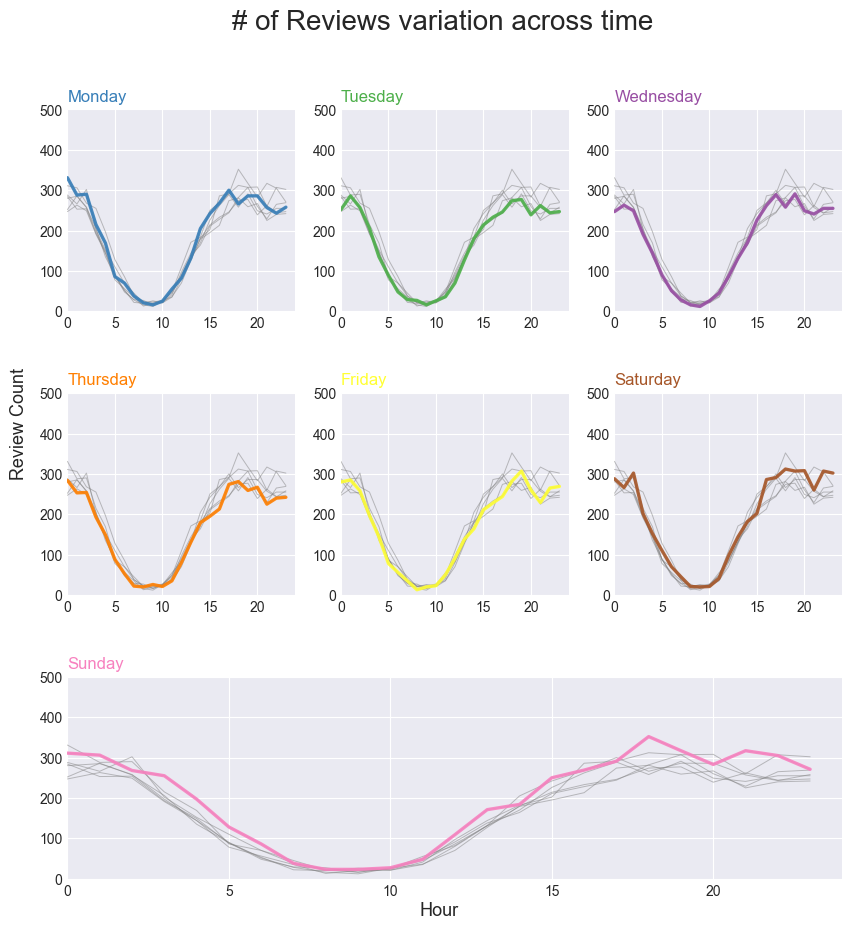

In [31]:
import matplotlib.gridspec as gridspec 
plt.style.use('seaborn-darkgrid')
# create a color palette
palette = plt.get_cmap('Set1')
plt.figure(figsize=(10,10))
plt.suptitle("# of Reviews variation across time",fontsize=20)
gridspec.GridSpec(3,3)
plt.subplots_adjust(hspace=0.4)

# multiple line plot
num=0
for column in df.drop('hour', axis=1).columns:
    num+=1
    # Find the right spot on the plot
    
    if num==7:  # adjustment to fit Sunday
        plt.subplot2grid((3,3),(2,0),colspan=3)
    else:
        plt.subplot(3,3, num)
    
    # plot every groups, but discreet
    for v in df.drop('hour', axis=1).columns:
        plt.plot(df['hour'], df[v], marker='', color='gray', linewidth=0.7, alpha=0.5)
    # Plot the lineplot
    plt.plot(df['hour'], df[column], marker='', color=palette(num), linewidth=2.4, alpha=0.9, label=column)
    plt.xlim(0,24,2)
    plt.ylim(-2,500)
    # Not ticks everywhere
    if num in range(4) :
        plt.tick_params(labelbottom='off')
    if num not in [1,4,7] :
        plt.tick_params(labelleft='off')
    # Add title
    plt.title(column, loc='left', fontsize=12, fontweight=0, color=palette(num))

plt.text(11.5, -90, 'Hour', ha='center',fontsize=13)
plt.text(-1.5, 1000, 'Review Count', ha='center',fontsize=13,rotation='vertical')

<font size=4>1. On the weekend, we have more reviews than other workdays. 
    
<font size=4>2. A large volume of reviews are posted in the evening, at midnight, and early in the morning.</font> 



In [32]:
# Merge with Business dataset to get the business category of certain review
Review_S = pd.merge(Review_S,business.loc[:,['business_id','category']],on='business_id')
Review_S=Review_S[(Review_S['year']>2008) & (Review_S['year']<2022) ]

In [33]:
# Calculate the review amounts by year and business category 
df = Review_S.groupby(['year','category'])['review_id'].count()
df=df.reset_index()
df=df.pivot(index='year',columns='category')[['review_id']]
df.columns = df.columns.droplevel()
df=df.reset_index()
df.fillna(0, inplace=True)
# df.drop(['None','others'],axis=1,inplace=True)
df.drop(['others'],axis=1,inplace=True)

In [34]:
# Calculate the review% of all business categories in a certain year
fields = [' Bars', ' Beauty & Spas', ' Event Planning & Services',
       ' Food', ' Health & Medical', ' Home Services', ' Local Services',
       ' Nightlife', ' Restaurants', ' Shopping']

df['sum'] = df[fields].sum(axis=1)
for i in fields:
    df['{}_Percent'.format(i)] = df[i] / df['sum']
df.set_index(["year"], inplace=True)
df

category,Bars,Beauty & Spas,Event Planning & Services,Food,Health & Medical,Home Services,Local Services,Nightlife,Restaurants,Shopping,sum,Bars_Percent,Beauty & Spas_Percent,Event Planning & Services_Percent,Food_Percent,Health & Medical_Percent,Home Services_Percent,Local Services_Percent,Nightlife_Percent,Restaurants_Percent,Shopping_Percent
year,,,,,,,,,,,,,,,,,,,,,
2009,24.0,5.0,13.0,36.0,4.0,2.0,0.0,32.0,128.0,14.0,258.0,0.093023,0.019380,0.050388,0.139535,0.015504,0.007752,0.000000,0.124031,0.496124,0.054264
2010,54.0,16.0,22.0,76.0,1.0,4.0,5.0,54.0,213.0,30.0,475.0,0.113684,0.033684,0.046316,0.160000,0.002105,0.008421,0.010526,0.113684,0.448421,0.063158
2011,73.0,27.0,37.0,114.0,9.0,7.0,13.0,67.0,349.0,40.0,736.0,0.099185,0.036685,0.050272,0.154891,0.012228,0.009511,0.017663,0.091033,0.474185,0.054348
2012,91.0,23.0,61.0,160.0,19.0,10.0,14.0,82.0,449.0,54.0,963.0,0.094496,0.023884,0.063344,0.166147,0.019730,0.010384,0.014538,0.085151,0.466251,0.056075
2013,102.0,48.0,63.0,177.0,24.0,26.0,28.0,99.0,568.0,80.0,1215.0,0.083951,0.039506,0.051852,0.145679,0.019753,0.021399,0.023045,0.081481,0.467490,0.065844
2014,142.0,81.0,106.0,247.0,21.0,34.0,28.0,162.0,780.0,96.0,1697.0,0.083677,0.047731,0.062463,0.145551,0.012375,0.020035,0.016500,0.095463,0.459635,0.056570
2015,176.0,105.0,139.0,332.0,48.0,43.0,42.0,231.0,1006.0,110.0,2232.0,0.078853,0.047043,0.062276,0.148746,0.021505,0.019265,0.018817,0.103495,0.450717,0.049283
2016,207.0,103.0,140.0,412.0,51.0,67.0,60.0,247.0,1151.0,129.0,2567.0,0.080639,0.040125,0.054538,0.160499,0.019868,0.026101,0.023374,0.096221,0.448383,0.050253
2017,286.0,123.0,124.0,391.0,76.0,68.0,44.0,236.0,1236.0,127.0,2711.0,0.105496,0.045371,0.045740,0.144227,0.028034,0.025083,0.016230,0.087053,0.455920,0.046846


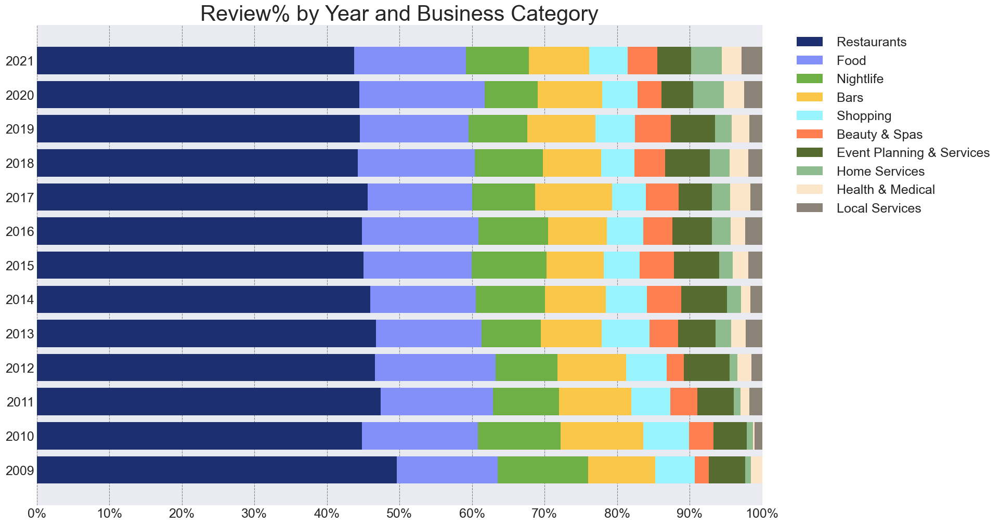

In [35]:
labels = [' Restaurants',' Food',' Nightlife',' Bars',' Shopping',' Beauty & Spas',' Event Planning & Services',' Home Services',' Health & Medical',' Local Services']
colors = ['#1D2F6F', '#8390FA', '#6EAF46', '#FAC748','#98F5FF','#FF7F50','#556B2F','#8FBC8F','#FCE6C9','#8B8378']
title = 'Review% by Year and Business Category'

def plot_stackedbar_p(df, labels, colors, title):
    fields = ['{}_Percent'.format(i) for i in labels]
    fig, ax = plt.subplots(1, figsize=(18, 12))
    left = len(df) * [0]
    # draw bars for each category
    for idx, name in enumerate(fields):
        plt.barh(df.index, df[name], left = left, color=colors[idx])
        # make bars stacked
        left = left + df[name]

    plt.title(title,fontsize=30)
    plt.legend(labels, bbox_to_anchor=([0.58, 1, 0.75, 0]), ncol=1, frameon=False, prop = {'size':18})
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(False)

    xticks = np.arange(0,1.1,0.1)
    xlabels = ['{}%'.format(i) for i in np.arange(0,101,10)]
    plt.xticks(xticks, xlabels,fontsize =18)
    yticks = np.arange(2009,2022,1)
    ylabels = np.arange(2009,2022,1)
    plt.yticks(yticks, ylabels,fontsize =18)
    ax.xaxis.grid(color='gray', linestyle='dashed')
plt.show()

plot_stackedbar_p(df, labels, colors, title)

<font size=4>Here, we want to see how our reviews are contributed by different business categories and is there any variation over time.</font>   

<font size=4>1. About 60% of our reviews are about restaurants and food, and about 30% of reviews are about other entertainment.   
    
<font size=4>2. The other 4 categories are about something **not related to entertainment**(Represented by the last four colors). We can actually see a pattern that **the review amounts of this kind of business have an increasing trend**, which means **people are increasingly willing to share their experiences about these kinds of business** on Yelp.</font> 

### Review Text Cleaning

First, for the text itself, we need to do some cleaning and preprocessing since some of the reviews contains special characters as well as emojis. Also, after deleting the punctuation, we generated new features called *text_char_count* which is the length of the review and *text_cleaned_word_count* which represents the word count of the review.

In [36]:
path = os.getcwd() + "/sample_review_file.csv"
data = pd.read_csv(path)
# delete the stopwords
stop = sw.words("english")
text_cleaned = data['text'].dropna().apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))

# Get the length of text (the character count)
data["text_char_count"] = data["text"].str.len()

# Get the word count of text
data["text_cleaned_word_count"] = text_cleaned.str.split().str.len()

In [37]:
# review cleaning
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))

def sentence_remove(text):
    if type(text)!= type(' '): text = str(text)
    text = text.lower()
    r = "[_.!+-=——,$%^，。？、~@#￥%……&*《》<>「」“”‘’（）{}【】□‡()/／\\\[\]\"]"
    text = re.sub(r'[http|https]*://[a-zA-Z0-9.?/&=:]*', ' ', text)  # delete the url
    text = re.sub(r'@\S+', ' ', text)                                # delete "@user"
    text = re.sub(r, ' ', text)                                      # delete some special characters
    text = re.sub(r'\s+', ' ', text)                                 # Delete extra blank line breaks

    # delete Chinese, Japanese and Korean
    text = re.sub('[\u4e00-\u9fa5\uac00-\ud7ff\u3040-\u309f\u30a0-\u30ff]', '', text)
    
    return text

def remove_stopwords(document):
    
    words = [word for word in document if not word in stop_words]
    
    return words

text_cleaned = text_cleaned.apply(sentence_remove)#.tolist()
data['text_cleaned'] = text_cleaned.apply(sentence_remove)#.tolist()

In [38]:
date = pd.to_datetime(data['date'])
data['weekday'] = date.dt.day_name()
data['month'] = date.dt.month_name()
date = pd.to_datetime(date).dt.strftime('%Y-%m-%d')

In [39]:
def remove_stopwords(document):
    
    words = [word for word in document if not word in stop_words]
    
    return words

from nltk.stem import PorterStemmer

porter = PorterStemmer()

def stemmer(document):
    
    stemmed_document = [porter.stem(word) for word in document]
    
    return stemmed_document

In [40]:
from nltk.tokenize import word_tokenize
from nltk.tokenize.treebank import TreebankWordDetokenizer
from afinn import Afinn

# tokenize
text_tokenized = data['text_cleaned'].apply(word_tokenize)
# remove stop words
text_no_stop = text_tokenized.apply(remove_stopwords)
# get the stem
text_stemmed = text_no_stop.apply(stemmer)
# detokenize
text_detokenized = text_stemmed.apply(TreebankWordDetokenizer().detokenize)

### Generating Emotional Score

Moreover, we think we can learn a lot from the review's emotion. We tried two methods:
- Using the sentiment dictionary to generate emotional scores. In this project, we chose the Afinn dictionary and get the average score of a whole review. 
- Using pre-trianed model from huggingface.com. We choose *distilled RoBERTa*, which actually was trained in a lot of dataset, including a similar text dataset, to generate the emotional category.

However, due to the computational resource limitation, we run this using GPU computing instead of the local server.

Also, after looking into several theses, we decided that the golden rule is that we assign *positive* tag to reviews with scores over 5 , *Neutral* tag to reviews within [-3,5] and *Negative* tag to reviews lower than -3.

In [41]:
# Get the sentiment score using the dictionary: afinn
afinn = Afinn()
scored_sentences = ((afinn.score(sent), sent) for sent in text_detokenized)

In [42]:
t = []
e = []
for i,sent in enumerate(data['text']):
    t.append(afinn.score(sent)) 
    if afinn.score(sent) >= 5: e.append('Positive')
    elif afinn.score(sent) >= -3: e.append('Neutral')
    else: e.append('Negative')
# create a new feature called dict_sentiment
data["dict_sentiment"] = t
data['Emotion'] = e

### Merge Business with Review

We also want to discover the relationship between business dataset and review dataset, so we merge this datasets together based on the *business_id*.

In [43]:
business_review=pd.merge(data, business, on='business_id',how='left')

In [44]:
business_review.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 0 to 29999
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Unnamed: 0               30000 non-null  int64  
 1   review_id                30000 non-null  object 
 2   user_id                  30000 non-null  object 
 3   business_id              30000 non-null  object 
 4   stars_x                  30000 non-null  float64
 5   useful                   30000 non-null  int64  
 6   funny                    30000 non-null  int64  
 7   cool                     30000 non-null  int64  
 8   text                     30000 non-null  object 
 9   date                     30000 non-null  object 
 10  text_char_count          30000 non-null  int64  
 11  text_cleaned_word_count  30000 non-null  int64  
 12  text_cleaned             30000 non-null  object 
 13  weekday                  30000 non-null  object 
 14  month                 

### Numbers of reviews of different categories

Since in the preprocessing part, we generate a new column named *category*, after we merged the two datasets, the first thing we want to discover is the number of reviews of different categories.

In [45]:
business_review['wc'] = business_review['text'].dropna().apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
line_tokenized = [re.split(' ', text) for text in business_review["text_cleaned"].dropna()]
all_words = list(itertools.chain.from_iterable(line_tokenized))
all_characters = set(business_review.category)
all_emotions = set(business_review.Emotion)

Text(0.5, 1.0, 'Total Number of reviews for Top 10 categories')

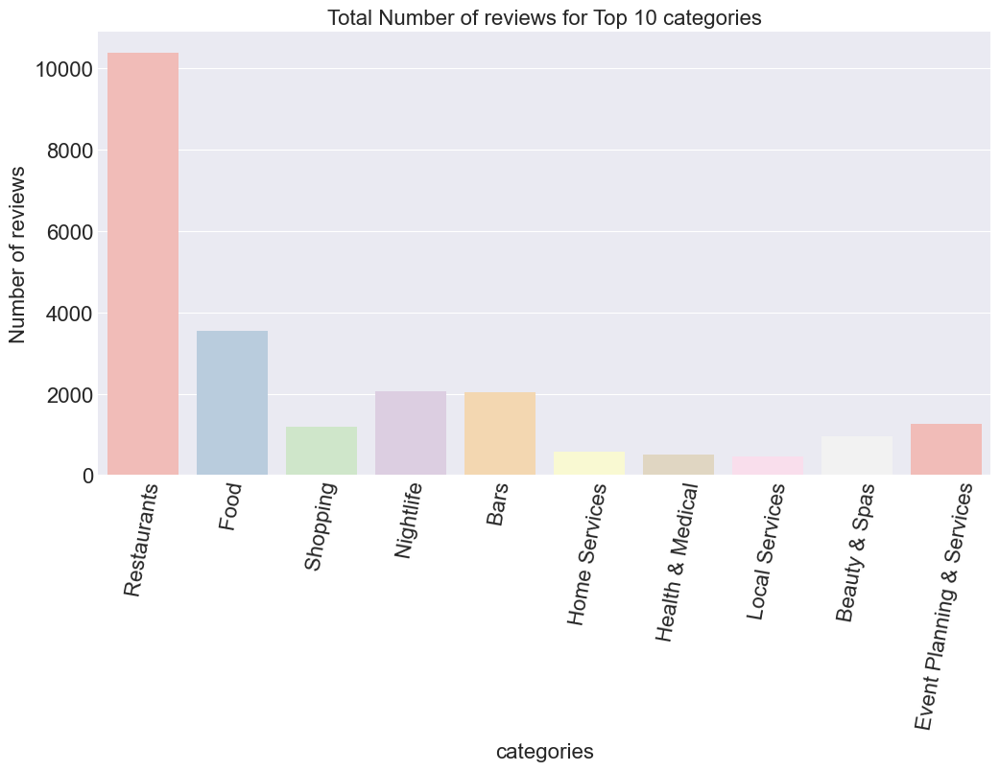

In [46]:
data.Characters = business_review.category.apply(lambda x: str.upper(x))
data_columns = list(business_review.columns)
Characters_per_rank = (cats.category.value_counts()).index
data_for_count_plot = business_review[business_review.category.isin(all_characters)]

fig = plt.figure(figsize=(12, 6), facecolor='white')
sns.countplot(x='category', order=Characters_per_rank[0:10], data=data_for_count_plot, palette='Pastel1') #, , color='cyan'
plt.xlabel("categories", fontsize=16)
plt.ylabel("Number of reviews", fontsize=16)
plt.xticks(rotation=80, fontsize=16)
plt.yticks(fontsize=16)
plt.title("Total Number of reviews for Top 10 categories", fontsize=16)

As we can see in the figure xxx, the *Restaurant* and *Food* categories contain a lot of reviews, followed by *Nightlife*, *Bars* and *Event Planning and Services*.

### Distribution of reviews of different categories

In [47]:
import ipywidgets as widgets
from ipywidgets import interact
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from PIL import Image
# from resizeimage import resizeimage
from skimage.transform import resize
from collections import Counter

def word_letter_density_distribution(Category):
    f, ax1 = plt.subplots(figsize=(8, 5))

    if Category in all_characters:
        letter_count = business_review["text"][business_review.category == Category].str.len()
        word_count = business_review["text"][business_review.category == Category].str.split(' ').str.len()
    else:
        letter_count = business_review["text"].str.len()
        word_count = business_review["text"].str.split(' ').str.len()
    plt1 = sns.distplot(letter_count[letter_count < 1000], ax=ax1, label='letters')
    plt2 = sns.distplot(word_count[word_count < 1000], ax=ax1, color='lightskyblue', label='words')
    legend = plt.legend(prop={'size': 16})
    title = plt.title('Density of words/letters')
    labels = ax1.set(xlabel='numbers', ylabel='Density')

    ax1.set_xlim(0, 700)
    ax1.set_ylim(0, 0.05)

    for item in ([ax1.title, ax1.xaxis.label, ax1.yaxis.label] +
                 ax1.get_xticklabels() + ax1.get_yticklabels()):
        item.set_fontsize(16)


Selection_Options = list(Characters_per_rank[:10])
Selection_Options.append(' All Categories')
style = {'description_width': 'initial'}
interact(word_letter_density_distribution, Category=Selection_Options, style=style)

interactive(children=(Dropdown(description='Category', options=(' Restaurants', ' Food', ' Shopping', ' Nightl…

<function __main__.word_letter_density_distribution(Category)>

To gain insights of the reviews of different categories, we use the **interact** widget and use a dropdown containing different categories to depict the distribution of length of reviews.
Due to the page limit, we choose *Restaurant* and *Health and Medical* categories as an example.
 - As we can see in the graph, the distribution of reviews in the *Restaurant* category is highly right skewed. People tend to give short reviews of restaurants.
 - However, the case is different when it comes to *Health and Medical*. We can find out that the distribution is slightly right skewed and people tend to give longer reviews about medical business.

### Wordcloud of different categories

In [48]:
stop_words.add('one',)
stop_words.add("I'm")
stop_words.add('yeah')

In [57]:
def show_wordcloud(data, Desired_Character='All Categories'):
    # mask采用friends动漫图片
    mask1 = np.array(Image.open("berkeley.png"))
    '''def transform_format(val):
        if val == 0:
            return 255
        else:
            return val
    transformed_mask = np.ndarray((mask.shape[0], mask.shape[1]), np.int32)
    for i in range(len(mask)):
        transformed_mask[i] = list(map(transform_format, mask[i]))
    '''

    wordcloud = WordCloud(stopwords=stop_words, width=800, height=400, background_color='white',
                              scale=3, max_words=200, mask=mask1, random_state=42,
                              contour_width=3, contour_color='steelblue').generate(str(data))


    fig = plt.figure(1, figsize=(10, 10))
    plt.title('WordCloud: {0}'.format(Desired_Character), fontsize=32, loc='center')
    plt.axis('off')
    fig.subplots_adjust(top=2.3)

    plt.tight_layout()
    plt.imshow(wordcloud, interpolation='bilinear')


def wordcloud_generator(Character, Emo):
    if Emo in all_emotions:
        if Character in all_characters:
            show_wordcloud(business_review["wc"][business_review.Emotion == Emo][business_review.category == Character], Character)
        else:
            show_wordcloud(business_review["wc"][business_review.Emotion == Emo])
    else:
        if Character in all_characters:
            show_wordcloud(business_review["wc"][business_review.category == Character], Character)
        else:
            show_wordcloud(business_review["wc"])

# features to visualize

Selection_Options = list(Characters_per_rank[:10])
Selection_Options.append(' All Categories')

origin = widgets.Dropdown(
    options=list(Selection_Options),
    description='Category', style=style)

Selection_Options2 = list(all_emotions)
Selection_Options2.append('All Emotions')

origin2 = widgets.Dropdown(
    options=list(Selection_Options2),
    description='Emotion', style=style)



interact(wordcloud_generator, Character=origin, Emo = origin2, style=style)




interactive(children=(Dropdown(description='Category', options=(' Restaurants', ' Food', ' Shopping', ' Nightl…

<function __main__.wordcloud_generator(Character, Emo)>

Moreover, we think wordcloud may give us some interesting insights. So I generate two widgets, category and emotion. We can see the wordcloud of different categories and emotions, and here are two examples.
 - **Wordcloud of all emotions reviews in restaurant category.**
  - We can find out that *Location* and *Drinks* matters the most to the majority of users, followed by *service* and *food*. Also, there is a large *great* in the restaurant category, which means a lot of people tend to give reviews when the restaurant is great.
 - **Wordcloud of all emotions reviews in health and medical category.**
  - The case is different when it comes to *health and medical*. As you can see, there is a large *Awful* in the wordcloud. Although *Location* is really important to most users, *appointment* and *doctor* actually matters a lot.

We can discover a lot through these wordcloud graphs, but due to the space limit, we can't show all the pictures here.

### Sankey Diagram of the data

In [50]:
category = set(business_review.category)
category.remove('others')
# category.remove('None')
all_regions = set(business_review.region)
all_regions.remove(None)
openornot = set(business_review.is_open)
t1 = []
all_stars = set(business_review.stars_x)
for i in all_stars:
    for j in openornot:
        t1.append(business_review["wc"][business_review.stars_x == i][business_review.is_open == j][business_review.category != 'others'].count())
for i in openornot:
    for j in category:
        t1.append(business_review["wc"][business_review.is_open == i][business_review.category == j][business_review.category != 'others'].count())
for i in category:
    for j in all_emotions:
        t1.append(business_review["wc"][business_review.Emotion == j][business_review.category == i].count())
all_weekdays = set(business_review.weekday)
for i in all_emotions:
    for j in all_regions:
        t1.append(business_review["wc"][business_review.Emotion == i][business_review.region == j][business_review.category != 'others'].count())

In [51]:
from webcolors import hex_to_rgb
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)  

In [52]:
node_label = []
for i in all_stars:
    node_label.append(str(i)+' stars')
node_label.append('Closed')
node_label.append('Opened')
for i in category:      
    node_label.append(i)
for i in all_emotions:      
    node_label.append(i)
for i in all_regions:
    node_label.append(i)
node_label

['1.0 stars',
 '2.0 stars',
 '3.0 stars',
 '4.0 stars',
 '5.0 stars',
 'Closed',
 'Opened',
 ' Event Planning & Services',
 ' Shopping',
 ' Home Services',
 ' Restaurants',
 ' Nightlife',
 ' Bars',
 ' Health & Medical',
 ' Food',
 ' Beauty & Spas',
 ' Local Services',
 'Negative',
 'Positive',
 'Neutral',
 'west',
 'midwest',
 'northeast',
 'southwest',
 'southeast']

In [53]:
node_label = []
for i in all_stars:
    node_label.append(str(i)+' stars')
node_label.append('Closed')
node_label.append('Opened')
for i in category:      
    node_label.append(i)
for i in all_emotions:      
    node_label.append(i)
for i in all_regions:
    node_label.append(i)
values = t1
source_label = [0,0,1,1,2,2,3,3,4,4,5,5,5,5,5,5,5,5,5,5,6,6,6,6,6,6,6,6,6,6,
                7,7,7,8,8,8,9,9,9,10,10,10,11,11,11,12,12,12,13,13,13,14,14,14,15,15,15,16,16,16,
                17,17,17,17,17,18,18,18,18,18,19,19,19,19,19]
target_label = [5,6,5,6,5,6,5,6,5,6,7,8,9,10,11,12,13,14,15,16,7,8,9,10,11,12,13,14,15,16,
                17,18,19,17,18,19,17,18,19,17,18,19,17,18,19,17,18,19,17,18,19,17,18,19,17,18,19,17,18,19,
                20,21,22,23,24,20,21,22,23,24,20,21,22,23,24]

In [54]:
node_color = ['black','black','black','black','black',
              'gray','gray',
              'dimgray','dimgray','dimgray','dimgray','dimgray','dimgray','dimgray','dimgray','dimgray','dimgray',
              'dimgrey','dimgrey','dimgrey',
              'black','black','black','black','black','black','black']

fig = go.Figure(
    data=[go.Sankey(
        node = dict(
            label = node_label,
            color = node_color
        ),
        link = dict(
      source = source_label, # indices correspond to labels, eg A1, A2, A1, B1, ...
      target = target_label,
      value = t1
    ))])
plot(fig,
     image_filename='sankey_plot_2', 
     image='png', 
     image_width=1000, 
     image_height=600
)
fig.show()


We also want to gain insights about the merged two datasets, so we use the sankey diagram to discover the data flow. This diagram actually contains a lot of information. 

For example, we can find some interesting facts here.
 - e.g. In the closed business, actually a large proportion of businesses has 5 stars. It's a bit counterintuitive as people may assume that the 5-star business is popular and will open for a long time and gain profits. However, maybe they are closed and have no chance to receive bad reviews and that's why they can keep "perfect" forever.
 - People in the east tend to give more positive reviews and maybe they are less picky than people in the west. But the reason can also be that there are more yelp users in the east area of the United States. 

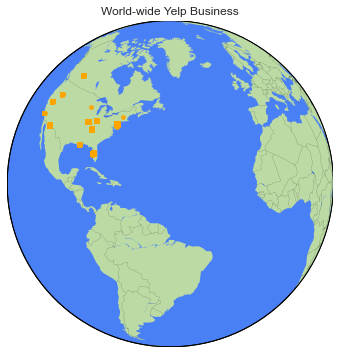

In [55]:
#basic basemap of the world
plt.figure(1, figsize=(15,6))
# use ortho projection for the globe type version
m1=Basemap(projection='ortho',lat_0=20,lon_0=-50)

# hex codes from google maps color pallete = http://www.color-hex.com/color-palette/9261
#add continents
m1.fillcontinents(color='#bbdaa4',lake_color='#4a80f5') 
# add the oceans
m1.drawmapboundary(fill_color='#4a80f5')                
# Draw the boundaries of the countires
m1.drawcountries(linewidth=0.1, color="black")

#Add the scatter points to indicate the locations of the businesses
mxy = m1(business["longitude"].tolist(), business["latitude"].tolist())
m1.scatter(mxy[0], mxy[1], s=3, c="orange", lw=3, alpha=1, zorder=5)
plt.title("World-wide Yelp Business")
plt.show()

Total Number of Restaurants: 150346


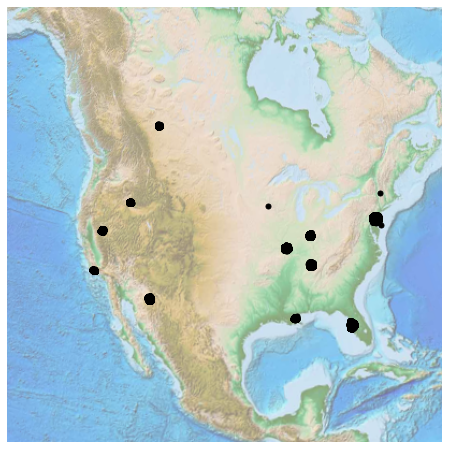

In [56]:
###Show the geographical distribution all restaurants in United States in the map
fig = plt.figure(figsize=(8, 8))
m = Basemap(projection='lcc', resolution=None,
            width=6E6, height=6E6, 
            lat_0=42, lon_0=-100)

m.etopo(scale=0.5, alpha=0.5)

x=business["longitude"].values
y=business["latitude"].values
x, y = m(x, y)
plt.plot(x, y, 'ok', markersize=5)

##Number of total restuarants shown in the map
print("Total Number of Restaurants:", x.size)